In [1]:
import ETFs as etfs
import yfinance as yf
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from datetime import datetime, timezone
import seaborn as sns

Total number of ETFs: 33


In [ ]:
data = pd.read_csv('../dataProcessing/assets_wide_NAN.csv', parse_dates=True, index_col=0)
display(data.head())

,AIEQ,ASHR.L,BCHN.L,CORN,DBO,EDEN,EMXC,EWA,EWC,EWG,...,SLV,SPY,TLT,USO,VDE,VDNR.L,VGK,VNQ,VPL,XMAF.L
Date,,,,,,,,,,,,,,,,,,,,,
2012-01-03,NaN,NaN,NaN,42.619999,26.042213,NaN,NaN,12.307325,20.625572,14.720882,...,28.830000,100.450653,83.888611,317.519989,69.905632,NaN,27.664728,34.591946,33.707802,6.78375
2012-01-04,NaN,NaN,NaN,42.509998,26.165096,NaN,NaN,12.452251,20.587934,14.581520,...,28.389999,100.608246,82.891197,318.160004,70.114937,NaN,27.328697,34.000519,33.888031,6.69750
2012-01-05,NaN,NaN,NaN,41.509998,25.814005,NaN,NaN,12.290601,20.459967,14.412820,...,28.510000,100.876122,82.743683,313.359985,69.817909,NaN,26.831099,34.319889,33.472141,6.68250
2012-01-06,NaN,NaN,NaN,41.349998,25.919331,NaN,NaN,12.128963,20.249189,14.148768,...,27.910000,100.616127,83.396904,313.760010,69.392517,NaN,26.462748,34.207520,33.070122,6.72625
2012-01-09,NaN,NaN,NaN,42.189999,25.831560,NaN,NaN,12.167977,20.309418,14.207448,...,28.129999,100.860359,83.249397,312.640015,69.655846,NaN,26.663082,34.089230,33.097836,6.69625


In [6]:
correlation_matrix = data.corr()
print(correlation_matrix)

             AIEQ    ASHR.L    BCHN.L      CORN       DBO      EDEN      EMXC  \
AIEQ     1.000000  0.508734  0.954371  0.363572  0.523861  0.841998  0.880619   
ASHR.L   0.508734  1.000000  0.563373 -0.289491 -0.345062  0.478072  0.393309   
BCHN.L   0.954371  0.563373  1.000000  0.216612  0.352469  0.706448  0.863033   
CORN     0.363572 -0.289491  0.216612  1.000000  0.841657 -0.487864  0.400325   
DBO      0.523861 -0.345062  0.352469  0.841657  1.000000 -0.302825  0.607942   
EDEN     0.841998  0.478072  0.706448 -0.487864 -0.302825  1.000000  0.868478   
EMXC     0.880619  0.393309  0.863033  0.400325  0.607942  0.868478  1.000000   
EWA      0.853028  0.417774  0.716466 -0.324477 -0.089391  0.926814  0.923355   
EWC      0.864694  0.391869  0.723537 -0.253090 -0.017573  0.920302  0.893603   
EWG      0.713387  0.477667  0.780572 -0.570545 -0.321986  0.844279  0.849583   
EWH     -0.002239  0.756265  0.203512 -0.689309 -0.603509  0.528608 -0.015031   
EWJ      0.856311  0.578484 

In [8]:
close_prices_mean = data.mean()
mean_df = pd.DataFrame(close_prices_mean, columns=['Mean'])
close_prices_std = data.std()
mean_df['Std'] = close_prices_std
display(mean_df)

,Mean,Std
AIEQ,30.816861,5.995812
ASHR.L,10.143544,2.146835
BCHN.L,77.622985,26.862915
CORN,23.559210,8.804752
DBO,13.659061,6.124370
EDEN,66.259472,28.938149
EMXC,48.211499,6.546857
EWA,17.528584,3.616750
EWC,26.618087,6.246882
EWG,24.381480,4.514025


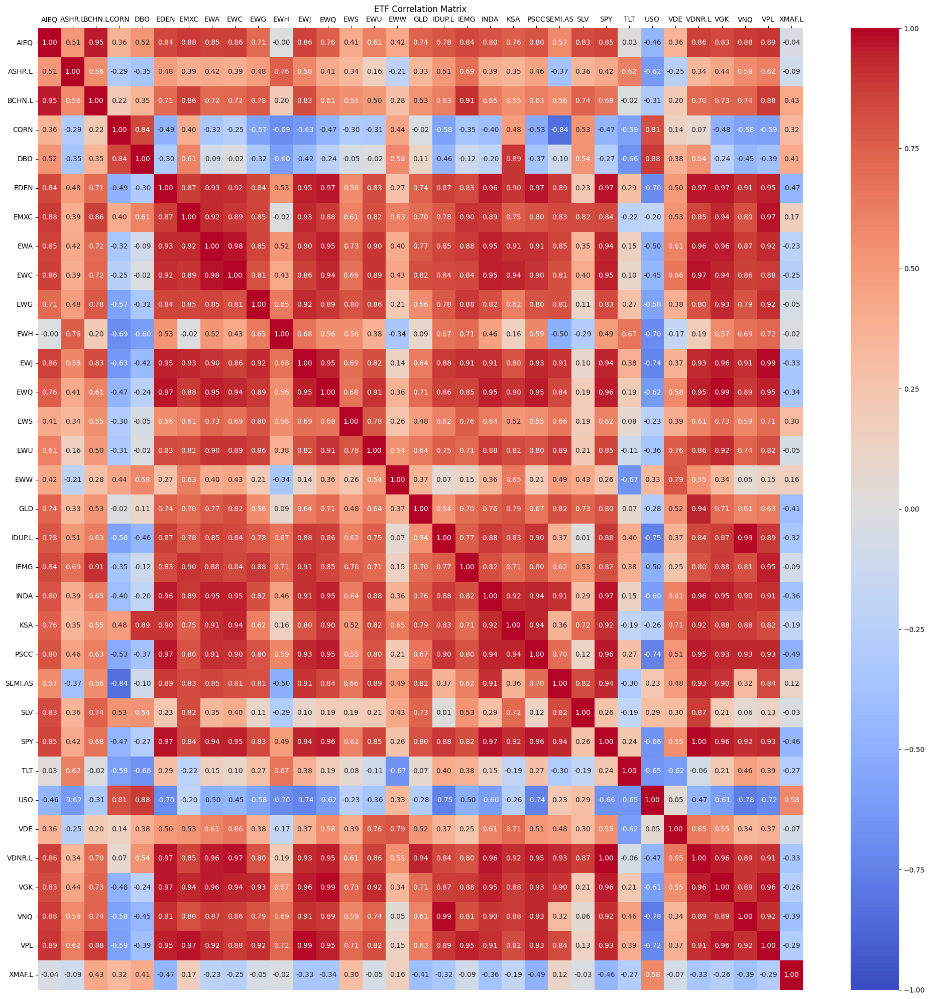

In [9]:
plt.figure(figsize=(20, 20))
sns.heatmap(correlation_matrix, fmt=".2f", annot=True, cmap='coolwarm', vmin=-1, vmax=1)
plt.title('ETF Correlation Matrix')
plt.xticks(rotation=90) 
plt.gca().xaxis.tick_top()  
plt.gca().xaxis.set_label_position('top') 
plt.tight_layout()
plt.show()

In [17]:
import seaborn as sns
g = sns.pairplot(close_prices)


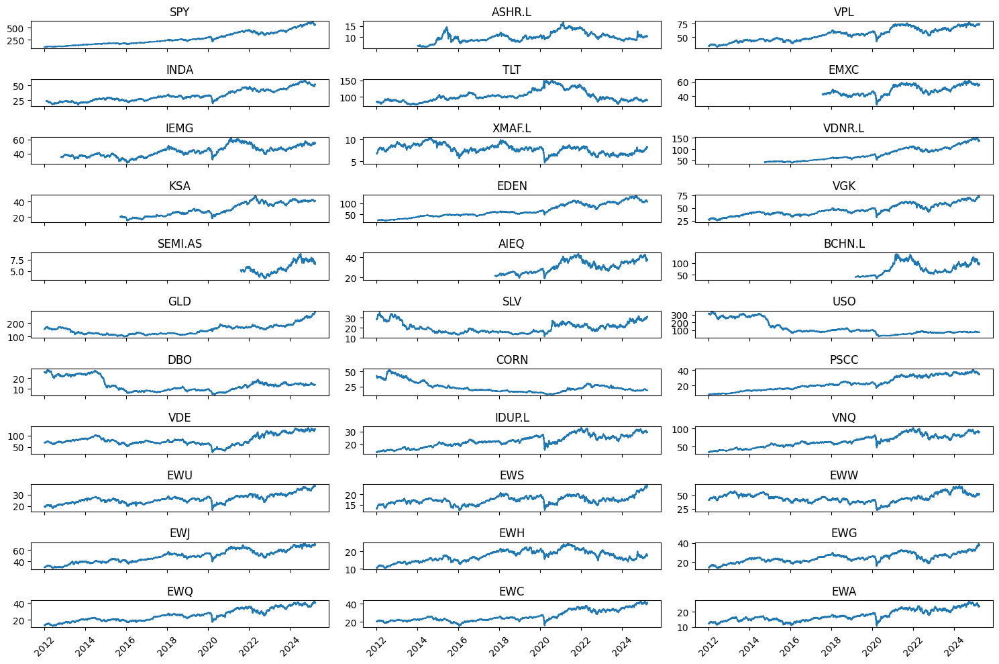

In [18]:

# List of stocks you want to plot
stocks =  ['SPY', 'ASHR.L', 'VPL', 'INDA', 'TLT', 'EMXC', 'IEMG', 'XMAF.L', 'VDNR.L', 'KSA', 'EDEN', 'VGK', 'SEMI.AS', 'AIEQ', 'BCHN.L', 'GLD', 'SLV', 'USO', 'DBO', 'CORN', 'PSCC', 'VDE', 'IDUP.L', 'VNQ', 'EWU', 'EWS', 'EWW', 'EWJ', 'EWH', 'EWG', 'EWQ', 'EWC', 'EWA']

# Set up grid size
n_rows = 11
n_cols = 3

fig, axes = plt.subplots(n_rows, n_cols, figsize=(15, 10), sharex=True)
axes = axes.flatten()  # Make it easier to index

for i, stock in enumerate(stocks):
    axes[i].plot(close_prices.index, close_prices[stock])
    axes[i].set_title(stock)
    axes[i].tick_params(axis='x', rotation=45)

# Remove any unused subplots (if stocks list is shorter than grid)
for j in range(len(stocks), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()
